In [2]:
import pandas as pd
import numpy as np
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go

In [ ]:
house_df = pd.read_pickle('abvHouse.pkl')
jobs_df = pd.read_pickle('jobFeatures.pkl')
yearTotals = pd.read_pickle('yearTotals.pkl')

df = house_df

df = pd.merge(df, jobs_df, on = 'Year', how = 'left')
df = pd.merge(df, yearTotals, on = 'Year', how = 'left')

df = df.replace(np.nan,0)
df= df.drop(columns = ['All Occupations', 'TAV'])

df.to_pickle('gen_Build.pkl')
df

In [ ]:
#df = pd.read_pickle('jobFeatures.pkl')
df = pd.read_pickle('jobShift.pkl')
df1 = pd.read_pickle('abvHouse.pkl')
df2 = df2[df1['Area'] == 'BOISE BENCH']

fig = go.Figure()

fig.add_trace(go.Scatter(x=df['Year'], y=df['Arts, Design, Entertainment, Sports, And Media Occupations'],
                    mode='lines',
                    name='lines'))

fig.show()

#df

In [ ]:

df1 = pd.read_pickle('abvHouse.pkl')
df2 = df1[df1['Area'] == 'BOISE BENCH']
#df2


# fig = go.Figure()

# fig.add_trace(go.Scatter(x=df2['Year'], y=df2['TAV_Ch'].mean(),
#                     mode='lines',
#                     name='lines'))

# fig.show()

fig = px.box(df2, x = 'Year', y="TAV_Ch")
fig.show()

In [ ]:
from scipy import stats

df = pd.read_pickle('abvHouse.pkl')
df = df[df['Area'] == 'BOISE BENCH']
df2 = df.copy()
df2 = df2[df2["Parcel"] == 'R2024320455']

df = df[((df.TAV_Ch - df.TAV_Ch.mean()) / df.TAV_Ch.std()).abs() < 3]



fig = px.box(df, x = 'Year', y="TAV_Ch")
fig.show()



In [ ]:
df = pd.read_pickle('abvHouse.pkl')
df = df[df['Area'] == 'BOISE BENCH']
df2 = df.copy()
df2 = df2[df2["Parcel"] == 'R2024320455']

df = df[((df.TAV_Ch - df.TAV_Ch.mean()) / df.TAV_Ch.std()).abs() < 3]
df2 = df2[((df2.TAV_Ch - df2.TAV_Ch.mean()) / df2.TAV_Ch.std()).abs() < 3]


fig = go.Figure()
# Use x instead of y argument for horizontal plot
fig.add_trace(go.Box(x=df['Year'], y = df['TAV_Ch']))
fig.add_trace(go.Box(x=df2['Year'], y = df2['TAV_Ch']))

fig.show()

In [6]:
df = pd.read_pickle('abvHouse.pkl')
df = df[df['Area'] == 'BOISE BENCH']
df2 = df.copy()
df2 = df2[df2["Neighborhood"] == 'CENTRAL BOISE BENCH']
df3 = pd.read_pickle('jobShift.pkl')


df = df[((df.TAV_Ch - df.TAV_Ch.mean()) / df.TAV_Ch.std()).abs() < 3]
df2 = df2[((df2.TAV_Ch - df2.TAV_Ch.mean()) / df2.TAV_Ch.std()).abs() < 3]


fig = go.Figure()
# Use x instead of y argument for horizontal plot
fig.add_trace(go.Box(x=df['Year'], y = df['TAV_Ch']))
#fig.add_trace(go.Box(x=df2['Year'], y = df2['TAV_Ch']))
fig.add_trace(go.Scatter(x=df3['Year'], y=df3['Arts, Design, Entertainment, Sports, And Media Occupations'],
                    mode='lines',
                    name='02'))

# fig.add_trace(go.Scatter(x=df3['Year'], y=df3['Computer And Mathematical Occupations'],
#                     mode='lines',
#                     name='05'))

fig.add_trace(go.Scatter(x=df3['Year'], y=df3['Sales And Related Occupations'],
                    mode='lines',
                    name='29'))

fig.show()

In [ ]:
df = pd.read_pickle('abvHouse.pkl')
df = df[df['Area'] == 'BOISE BENCH']

fig = px.histogram(df, x="TAV_Ch")
fig.show()

In [ ]:
df = pd.read_pickle('abvHouse.pkl')
df = df[df['Area'] == 'BOISE BENCH']

df = df[((df.TAV_Ch - df.TAV_Ch.mean()) / df.TAV_Ch.std()).abs() < 3]
fig = px.histogram(df, x="TAV_Ch")
fig.show()


 mu = 0.05 and sigma = 0.14



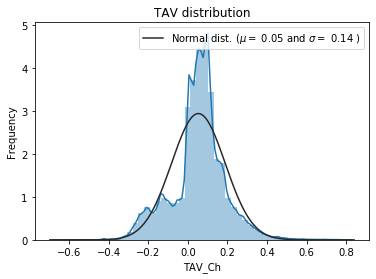

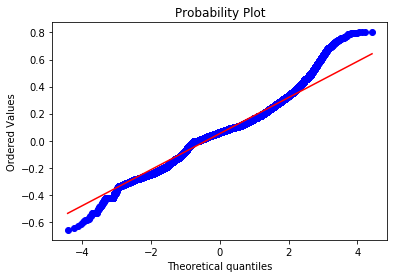

Skewness: -0.026754
Kurtosis: 1.582886


In [11]:
import seaborn as sns
from scipy.stats import norm
import matplotlib.pyplot as plt
from scipy import stats

df = pd.read_pickle('abvHouse.pkl')
df = df[df['Area'] == 'BOISE BENCH']
df2 = df.copy()
df2 = df2[df2["Neighborhood"] == 'CENTRAL BOISE BENCH']
df3 = pd.read_pickle('jobShift.pkl')


df = df[((df.TAV_Ch - df.TAV_Ch.mean()) / df.TAV_Ch.std()).abs() < 3]
df2 = df2[((df2.TAV_Ch - df2.TAV_Ch.mean()) / df2.TAV_Ch.std()).abs() < 3]



sns.distplot(df2['TAV_Ch'], fit = norm);

(mu, sigma) = norm.fit(df2['TAV_Ch'])
print( '\n mu = {:.2f} and sigma = {:.2f}\n'.format(mu, sigma))
plt.legend(['Normal dist. ($\mu=$ {:.2f} and $\sigma=$ {:.2f} )'.format(mu, sigma)],
            loc='best')
plt.ylabel('Frequency')
plt.title('TAV distribution')

fig = plt.figure()
res = stats.probplot(df2['TAV_Ch'], plot=plt)
plt.show()

print("Skewness: %f" % df2['TAV_Ch'].skew())
print("Kurtosis: %f" % df2['TAV_Ch'].kurt())

The values for asymmetry and kurtosis between -2 and +2 are considered acceptable in order to prove normal univariate distribution (George & Mallery, 2010). George, D., & Mallery, M. (2010). SPSS for Windows Step by Step: A Simple Guide and Reference, 17.0 update (10a ed.) Boston: Pearson.

In [46]:
import seaborn as sns
from scipy.stats import norm
import matplotlib.pyplot as plt
from scipy import stats

df = pd.read_pickle('abvHouse.pkl')
df = df[df['Area'] == 'BOISE BENCH']
yearTotals = pd.read_pickle('yrTotalChange.pkl')

df3 = pd.read_pickle('jobShift.pkl')
df = df[((df.TAV_Ch - df.TAV_Ch.mean()) / df.TAV_Ch.std()).abs() < 3]

df = pd.merge(df, df3, on = 'Year', how = 'left')
df = pd.merge(df, yearTotals, on = 'Year', how = 'left')

lm_df = df.copy()

lm_df = lm_df[lm_df['Year'] != '2000-01-01']

lm_df = lm_df.drop(['Parcel', 'Year', 'Group' ,'Neighborhood', 'Area', 'Age', 'Bedroom_Count',
                   'Bathroom_Count', 'TAV', 'All Occupations', 'Architecture And Engineering Occupations',
                   'Business And Financial Operations Occupations', 'Community And Social Service Occupations',
                   'Computer And Mathematical Occupations', 'Construction And Extraction Occupations',
                   'Education, Training, And Library Occupations', 'Farming, Fishing, And Forestry Occupations',
                   'Healthcare Practitioner And Technical Occupations', 'Installation, Maintenance, And Repair Occupations',
                   'Legal Occupations','Healthcare Support Occupations', 'Life, Physical, And Social Science Occupations',
                   'Office And Administrative Support Occupations', 'Personal Care And Service Occupations',
                   'Protective Service Occupations','(10000.0, 40000.0]', '(40000.0, 70000.0]', '(70000.0, 100000.0]',
                   '(100000.0, 150000.0]', '(150000.0, 200000.0]', '(200000.0, 300000.0]'], axis = 1)

lm_df.head()
# train = df.sample(frac = 0.75, random_state = 0)
# test = df.drop(train.index)
# train.drop('Parcel', axis =1, inplace = True)
# test.drop('Parcel', axis =1, inplace = True)

,TAV_Ch,"Arts, Design, Entertainment, Sports, And Media Occupations",Building And Grounds Cleaning And Maintenance Occupations,Food Preparation And Serving Related Occupations,Management Occupations,Production Occupations,Sales And Related Occupations,Transportation And Material Moving Occupations,Total_House_Change,Total_Pop_Change,Total_Emp_Change
117,0.127808,-0.091575,0.005284,0.015385,0.016466,-0.134979,-0.025046,-0.045546,0.034815,0.036376,-0.033423
118,0.149061,-0.091575,0.005284,0.015385,0.016466,-0.134979,-0.025046,-0.045546,0.034815,0.036376,-0.033423
119,0.145267,-0.091575,0.005284,0.015385,0.016466,-0.134979,-0.025046,-0.045546,0.034815,0.036376,-0.033423
120,0.163793,-0.091575,0.005284,0.015385,0.016466,-0.134979,-0.025046,-0.045546,0.034815,0.036376,-0.033423
121,0.149329,-0.091575,0.005284,0.015385,0.016466,-0.134979,-0.025046,-0.045546,0.034815,0.036376,-0.033423


In [40]:
# this is the standard import if you're using "formula notation" (similar to R)
import statsmodels.formula.api as smf

# create a fitted model in one line
lm = smf.ols(formula='TAV_Ch ~ Total_House_Change', data=lm_df).fit()


#print the coefficients
lm.params


Intercept            -0.075740
Total_House_Change    5.285386
dtype: float64

In [51]:
from sklearn.linear_model import LinearRegression


feature_cols = ['Arts, Design, Entertainment, Sports, And Media Occupations',
                'Building And Grounds Cleaning And Maintenance Occupations',
               'Food Preparation And Serving Related Occupations','Management Occupations',
               'Production Occupations','Sales And Related Occupations',
               'Transportation And Material Moving Occupations', 'Total_House_Change',
               'Total_Pop_Change', 'Total_Emp_Change']
y = lm_df.TAV_Ch
X = lm_df[feature_cols]

lm = LinearRegression()
lm.fit(X, y)


# # print intercept and coefficients
# print(lm.intercept_)
# print(lm.coef_)

# pair the feature names with the coefficients
#zip(feature_cols, lm.coef_)

# predict for a new observation
#lm.predict([100, 25, 25])

# calculate the R-squared
lm.score(X, y)

0.6120273612162579